# Taller 3
Julian Sanabria Mejia jj.sanabria@uniandes.edu.co <br>
Salomón Novoa Montenegro s.novoa485@uniandes.edu.co <br>
Iván Saavedra Villamil ir.saavedra232@uniandes.edu.co <br>

MINE-4101: Ciencia de Dato Aplicada <br>
Univerisdad de los Andes

## Instalación Librerías

In [139]:
!pip install --upgrade pandas-profiling

In [140]:
!pip install markupsafe==2.0.1

In [141]:
# Importar librerías
import pandas as pd
from pandas_profiling import ProfileReport
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso

import matplotlib.pyplot as plt
import seaborn as sns
import pylev

In [142]:
# Configuración de Panadas para extender el número de filas y columnas a visualizar
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)

## Carga y revisión de la data

In [143]:
# Carga del archivo CSV como DataFrame de Pandas
df = pd.read_csv('./data/Data_Taller_3.csv', sep=';')

In [144]:
df

,JobSatisfaction,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,NewEmployee
0,4.0,41.0,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Fem,94,3,2,Sales Executive,Single,5993,19479,8,Y,Yes,11,3,1,80.0,0,8,0,1,6,4,0,5,0
1,2.0,49.0,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,3,Male,61,2,2,Research Scientist,Married,5130,24907,1,Y,No,23,4,4,80.0,1,10,3,3,10,7,1,7,0
2,3.0,37.0,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,3,4,Male,92,2,1,Laboratory Technician,Single,2090,2396,6,Y,Yes,15,3,2,80.0,0,7,3,3,0,0,0,0,0
3,3.0,33.0,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,4,4,Fem,56,3,1,Research Scientist,Married,2909,23159,1,Y,Yes,11,3,3,80.0,0,8,3,3,8,7,3,0,0
4,2.0,NaN,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,5,1,Male,40,3,1,Laboratory Technician,Married,3468,16632,9,Y,No,12,3,4,80.0,1,6,3,3,2,2,2,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1501,4.0,36.0,No,Non-Travel,845,Sales,1,5,Medical,1,1502,4,Female,45,3,2,Sales Executive,Single,6653,15276,4,Y,No,15,3,2,80.0,0,7,6,3,1,0,0,0,0
1502,2.0,49.0,No,Travel_Rarely,174,Sales,8,4,Technical Degree,1,1503,4,Male,56,2,4,Sales Executive,Married,13120,11879,6,Y,No,17,3,2,80.0,1,22,3,3,9,8,2,3,0
1503,1.0,27.0,No,Travel_Rarely,1302,Research & Development,19,3,Other,1,1504,4,Male,67,2,1,Laboratory Technician,Divorced,4066,16290,1,Y,No,11,3,1,80.0,2,7,3,3,7,7,0,7,0
1504,2.0,44.0,Yes,Travel_Frequently,429,Research & Development,1,2,Medical,1,1505,3,Male,99,3,1,Research Scientist,Divorced,2342,11092,1,Y,Yes,12,3,3,80.0,3,6,2,2,5,3,2,3,0


In [145]:
# Describe las dimensiones del DataFrame
df.shape

(1506, 36)

In [146]:
# Describe las columnas y su tipo del DataFrame cargado
df.dtypes

JobSatisfaction             float64
Age                         float64
Attrition                    object
BusinessTravel               object
DailyRate                     int64
Department                   object
DistanceFromHome              int64
Education                     int64
EducationField               object
EmployeeCount                 int64
EmployeeNumber                int64
EnvironmentSatisfaction       int64
Gender                       object
HourlyRate                    int64
JobInvolvement                int64
JobLevel                      int64
JobRole                      object
MaritalStatus                object
MonthlyIncome                 int64
MonthlyRate                   int64
NumCompaniesWorked            int64
Over18                       object
OverTime                     object
PercentSalaryHike             int64
PerformanceRating             int64
RelationshipSatisfaction      int64
StandardHours               float64
StockOptionLevel            

## Limpieza y preparación de datos

In [147]:
# Identificamos el número de missing values en cada columna
df.isnull().sum()

JobSatisfaction             12
Age                          3
Attrition                    1
BusinessTravel               0
DailyRate                    0
Department                   0
DistanceFromHome             0
Education                    0
EducationField               0
EmployeeCount                0
EmployeeNumber               0
EnvironmentSatisfaction      0
Gender                       0
HourlyRate                   0
JobInvolvement               0
JobLevel                     0
JobRole                      0
MaritalStatus                0
MonthlyIncome                0
MonthlyRate                  0
NumCompaniesWorked           0
Over18                       0
OverTime                     0
PercentSalaryHike            0
PerformanceRating            0
RelationshipSatisfaction     0
StandardHours                7
StockOptionLevel             0
TotalWorkingYears            0
TrainingTimesLastYear        0
WorkLifeBalance              0
YearsAtCompany               0
YearsInC

In [148]:
# Crear una expresion lambda para transformar Float a Int
floatToInt = lambda x: int(x)

### Limpieza y transformación columna JobSatisfaction

In [149]:
# Reviso los valores únicos para JobSatisfaction
df['JobSatisfaction'].unique()

array([ 4.,  2.,  3.,  1., nan])

<b>NOTA</b>: JobSatisfaction es la variable objetivo. Las 12 instancias que contienen valores nulos serán el conjunto de pruebas para el modelo. Por tanto no se aplica ninguna limpieza y/o transfromación sobre este campo.

### Limpieza y transformación columna Age

In [151]:
# Imputamos la variable Age con la mediana
df['Age'].fillna(df['Age'].median(), inplace=True)

In [152]:
# Aplicar lamda a todos los valores en la columna Age
df["Age"] = df["Age"].apply(floatToInt)

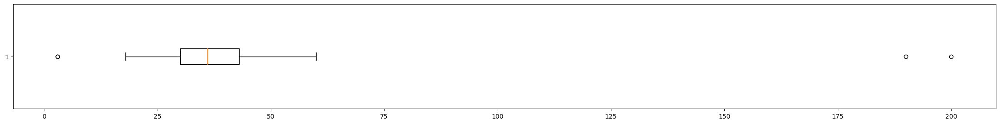

In [153]:
# Dispersión de los valores de la columna Age a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['Age'], vert = False)
plt.show()

In [154]:
# Función para corregir valores Age: si Age>100 entonces Age/100, si Age<10 entonces Age*10
def arreglar_edad(edad):
    if edad > 100:
        return edad / 10
    elif edad < 10:
        return edad * 10
    else:
        return edad

In [155]:
# uso función para arreglar valores de edad
df["Age"] = df["Age"].apply(arreglar_edad)

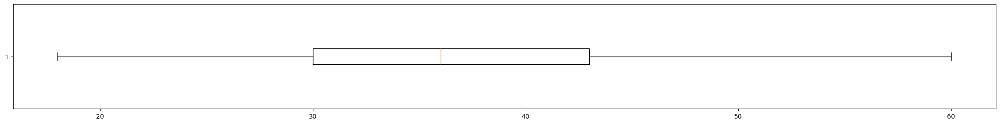

In [156]:
# Dispersión de los valores de la columna Age a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['Age'], vert = False)
plt.show()

### Limpieza y transformación columna Attrition

In [239]:
# Reviso los valores únicos para Attrition
df['Attrition'].unique()

array(['Yes', 'No', 'Na', nan], dtype=object)

In [240]:
# Imputamos la variable Attrition con la Na
df['Attrition'].fillna('Na', inplace=True)

In [241]:
# Reviso los valores únicos para Attrition
df['Attrition'].unique()

array(['Yes', 'No', 'Na'], dtype=object)

In [242]:
# Reemplazo valores Na por No
df['Attrition'] = df['Attrition'].replace('Na','No')

In [243]:
# Reviso los valores únicos para Attrition
df['Attrition'].unique()

array(['Yes', 'No'], dtype=object)

In [244]:
# Convierto variable categórica en numérica
df['Attrition'] = df['Attrition'].replace(['Yes', 'No'],[1,0])

In [245]:
# Reviso los valores únicos para Attrition
df['Attrition'].unique()

array([1, 0], dtype=int64)

### Limpieza y transformación columna BusinessTravel

In [157]:
# Reviso los valores únicos para BusinessTravel
df['BusinessTravel'].unique()

array(['Travel_Rarely', 'Travel_Frequently', 'Non-Travel'], dtype=object)

<b>NOTA</b>: Variable categórica para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna DailyRate

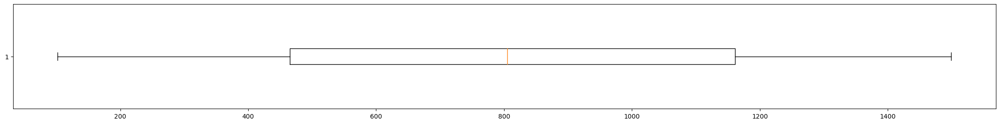

In [158]:
# Dispersión de los valores de la columna DailyRate a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['DailyRate'], vert = False)
plt.show()

In [159]:
# Análisis Univariado columna DailyRate
df['DailyRate'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean      803.978752
std       403.962331
min       102.000000
25%       465.000000
50%       805.000000
75%      1161.000000
95%      1422.750000
99%      1484.850000
max      1499.000000
Name: DailyRate, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna Department

In [160]:
# Reviso los valores únicos para Department
df['Department'].unique()

array(['Sales', 'Research & Development', 'Human Resources'], dtype=object)

<b>NOTA</b>: Variable categórica para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna DistanceFromHome

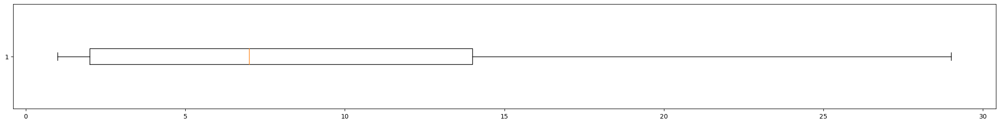

In [161]:
# Dispersión de los valores de la columna DistanceFromHome a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['DistanceFromHome'], vert = False)
plt.show()

In [162]:
# Análisis Univariado columna DistanceFromHome
df['DistanceFromHome'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        9.229084
std         8.135153
min         1.000000
25%         2.000000
50%         7.000000
75%        14.000000
95%        26.000000
99%        29.000000
max        29.000000
Name: DistanceFromHome, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna Education

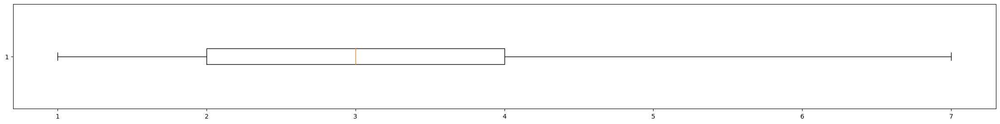

In [165]:
# Dispersión de los valores de la columna Education a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['Education'], vert = False)
plt.show()

In [166]:
# Análisis Univariado columna Education
df['Education'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        2.915671
std         1.031172
min         1.000000
25%         2.000000
50%         3.000000
75%         4.000000
95%         4.000000
99%         5.000000
max         7.000000
Name: Education, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna EducationField

In [167]:
# Reviso los valores únicos para EducationField
df['EducationField'].unique()

array(['Life Sciences', 'Other', 'Medical', 'Marketing',
       'Technical Degree', 'Human Resources', 'Med'], dtype=object)

In [168]:
# Reemplazo valores con el fin para dejar un valor único para medicina
df['EducationField'] = df['EducationField'].replace('Med','Medical')

In [169]:
# Reviso los valores únicos para EducationField
df['EducationField'].unique()

array(['Life Sciences', 'Other', 'Medical', 'Marketing',
       'Technical Degree', 'Human Resources'], dtype=object)

### Limpieza y transformación columna EmployeeCount

In [170]:
# Reviso los valores únicos para EmployeeCount
df['EmployeeCount'].unique()

array([1, 2], dtype=int64)

<b>NOTA</b>: existe una única instancia con valor 2 para este campo, el resto de instancias poseen el valor de 1, no se realizar limpieza y/o transformación ya que consideramos que es un campo que no aporta infomración y por tanto no la vamos a incluir en el modelo

### Limpieza y transformación columna EmployeeNumber

In [171]:
# Reviso los valores únicos para EmployeeNumber
df['EmployeeNumber'].unique()

array([   1,    2,    3, ..., 1504, 1505, 1506], dtype=int64)

<b>NOTA</b>: identificador único auto-incremental del empleado, no requiere limpieza y/o transformación y consideramos que es un campo que no aporta infomración y por tanto no la vamos a incluir en el modelo

### Limpieza y transformación columna EnvironmentSatisfaction

In [172]:
# Reviso los valores únicos para EnvironmentSatisfaction
df['EnvironmentSatisfaction'].unique()

array([2, 3, 4, 1], dtype=int64)

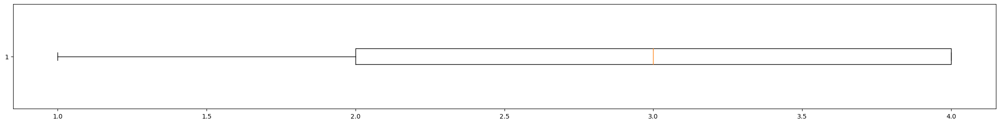

In [173]:
# Dispersión de los valores de la columna EnvironmentSatisfaction a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['EnvironmentSatisfaction'], vert = False)
plt.show()

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna Gender

In [174]:
# Reviso los valores únicos para Gender
df['Gender'].unique()

array(['Fem', 'Male', 'man', 'Female', 'female'], dtype=object)

In [175]:
# Reemplazo valores no válidos en Gender
df['Gender'] = df['Gender'].replace(['Fem', 'man', 'female'],['Female', 'Male', 'Female'])

In [176]:
# Reviso los valores únicos para Gender
df['Gender'].unique()

array(['Female', 'Male'], dtype=object)

In [177]:
# Trasformamos columna Gender en numérica
df['Gender'] = df['Gender'].replace(['Female', 'Male'],[0, 1])

In [178]:
# Reviso los valores únicos para Gender
df['Gender'].unique()

array([0, 1], dtype=int64)

### Limpieza y transformación columna HourlyRate

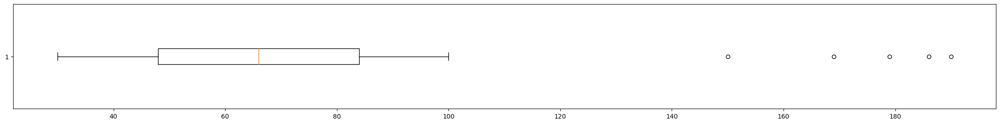

In [179]:
# Dispersión de los valores de la columna HourlyRate a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['HourlyRate'], vert = False)
plt.show()

In [180]:
# Análisis Univariado columna HourlyRate
df['HourlyRate'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean       66.280212
std        21.275971
min        30.000000
25%        48.000000
50%        66.000000
75%        84.000000
95%        97.000000
99%       100.000000
max       190.000000
Name: HourlyRate, dtype: float64

In [181]:
# Función para corregir valores HourlyRate: si HourlyRate>100 entonces HourlyRate-100
def arreglar_tarifa_hora(tarifa):
    if tarifa > 100:
        return tarifa - 100
    else:
        return tarifa

In [182]:
# uso función para arreglar los valores de HourlyRate
df["HourlyRate"] = df["HourlyRate"].apply(arreglar_tarifa_hora)

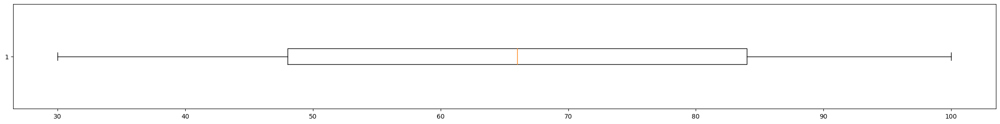

In [183]:
# Dispersión de los valores de la columna HourlyRate a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['HourlyRate'], vert = False)
plt.show()

### Limpieza y transformación columna JobInvolvement

In [184]:
# Reviso los valores únicos para JobInvolvement
df['JobInvolvement'].unique()

array([3, 2, 4, 1], dtype=int64)

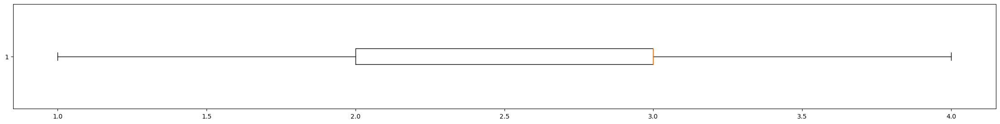

In [185]:
# Dispersión de los valores de la columna JobInvolvement a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['JobInvolvement'], vert = False)
plt.show()

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna JobLevel

In [186]:
# Reviso los valores únicos para JobLevel
df['JobLevel'].unique()

array([2, 1, 3, 4, 5], dtype=int64)

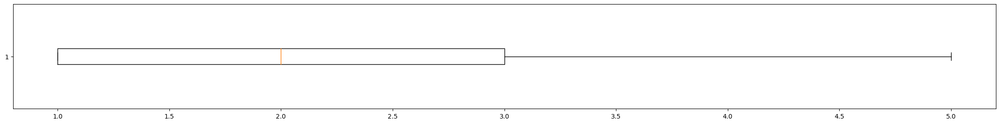

In [187]:
# Dispersión de los valores de la columna JobLevel a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['JobLevel'], vert = False)
plt.show()

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna JobRole

In [188]:
# Reviso los valores únicos para JobRole
df['JobRole'].unique()

array(['Sales Executive', 'Research Scientist', 'Laboratory Technician',
       'Manufacturing Director', 'Healthcare Representative', 'Manager',
       'Sales Representative', 'Research Director', 'Human Resources',
       'Lab Tech', 'RH'], dtype=object)

In [189]:
# Reemplazo valores no válidos en JobRole
df['JobRole'] = df['JobRole'].replace(['Sales Representative', 'Lab Tech', 'RH'],['Sales Executive', 'Laboratory Technician', 'Human Resources'])

In [190]:
# Reviso los valores únicos para JobRole
df['JobRole'].unique()

array(['Sales Executive', 'Research Scientist', 'Laboratory Technician',
       'Manufacturing Director', 'Healthcare Representative', 'Manager',
       'Research Director', 'Human Resources'], dtype=object)

### Limpieza y transformación columna MaritalStatus

In [191]:
# Reviso los valores únicos para MaritalStatus
df['MaritalStatus'].unique()

array(['Single', 'Married', 'Divorced', 'S', 'D', 'M'], dtype=object)

In [192]:
# Reemplazo valores no válidos en MaritalStatus
df['MaritalStatus'] = df['MaritalStatus'].replace(['S', 'D', 'M'],['Single', 'Divorced', 'Married'])

In [193]:
# Reviso los valores únicos para MaritalStatus
df['MaritalStatus'].unique()

array(['Single', 'Married', 'Divorced'], dtype=object)

### Limpieza y transformación columna MonthlyIncome

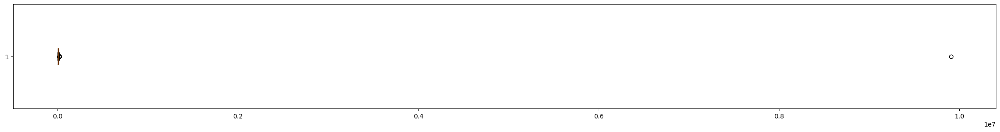

In [194]:
# Dispersión de los valores de la columna MonthlyIncome a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['MonthlyIncome'], vert = False)
plt.show()

In [195]:
# Análisis Univariado columna MonthlyIncome
df['MonthlyIncome'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1.506000e+03
mean     1.303036e+04
std      2.551646e+05
min      2.500000e+01
25%      2.886000e+03
50%      4.877500e+03
75%      8.307750e+03
95%      1.783675e+04
99%      1.962695e+04
max      9.907000e+06
Name: MonthlyIncome, dtype: float64

In [196]:
# Función para corregir valores MonthlyIncome: si MonthlyIncome>20000 entonces HourlyRate/1000
def arreglar_ingresos(ingresos):
    if ingresos > 20000:
        return ingresos / 1000
    else:
        return ingresos

In [197]:
# uso función para arreglar los valores de HourlyRate
df["MonthlyIncome"] = df["MonthlyIncome"].apply(arreglar_ingresos)

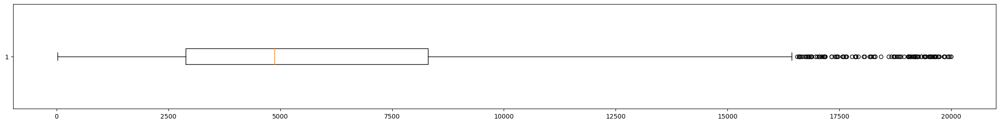

In [198]:
# Dispersión de los valores de la columna MonthlyIncome a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['MonthlyIncome'], vert = False)
plt.show()

### Limpieza y transformación columna MonthlyRate

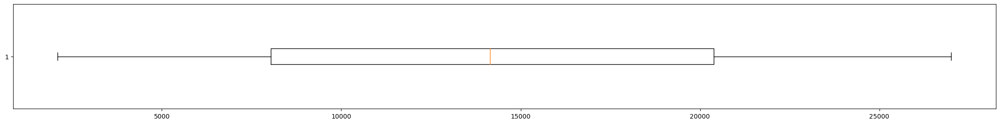

In [199]:
# Dispersión de los valores de la columna MonthlyRate a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['MonthlyRate'], vert = False)
plt.show()

In [200]:
# Análisis Univariado columna MonthlyRate
df['MonthlyRate'].describe(percentiles = [.25, .5, .75, .95, .99])

count     1506.000000
mean     14244.022576
std       7105.627164
min       2094.000000
25%       8041.250000
50%      14144.000000
75%      20385.500000
95%      25406.000000
99%      26698.800000
max      26999.000000
Name: MonthlyRate, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna NumCompaniesWorked

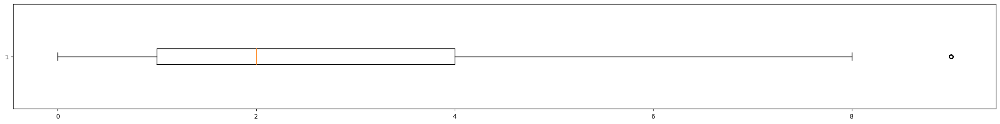

In [201]:
# Dispersión de los valores de la columna NumCompaniesWorked a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['NumCompaniesWorked'], vert = False)
plt.show()

In [202]:
# Análisis Univariado columna NumCompaniesWorked
df['NumCompaniesWorked'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        2.682603
std         2.484541
min         0.000000
25%         1.000000
50%         2.000000
75%         4.000000
95%         8.000000
99%         9.000000
max         9.000000
Name: NumCompaniesWorked, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna Over18

In [203]:
# Reviso los valores únicos para Over18
df['Over18'].unique()

array(['Y'], dtype=object)

<b>NOTA</b>: Variable categórica con único valor para todas las instancias. Consideramos que es una variable que no aporta infomración y por tanto no la vamos a incluir en el modelo

### Limpieza y transformación columna OverTime

In [204]:
# Reviso los valores únicos para OverTime
df['OverTime'].unique()

array(['Yes', 'No', 'Na'], dtype=object)

In [205]:
# Reemplazo valores no válidos en OverTime
df['OverTime'] = df['OverTime'].replace('Na','No')

In [206]:
# Reviso los valores únicos para OverTime
df['OverTime'].unique()

array(['Yes', 'No'], dtype=object)

In [207]:
# Trasformamos columna OverTime en numérica
df['OverTime'] = df['OverTime'].replace(['Yes', 'No'],[1, 0])

In [208]:
# Reviso los valores únicos para OverTime
df['OverTime'].unique()

array([1, 0], dtype=int64)

### Limpieza y transformación columna PercentSalaryHike

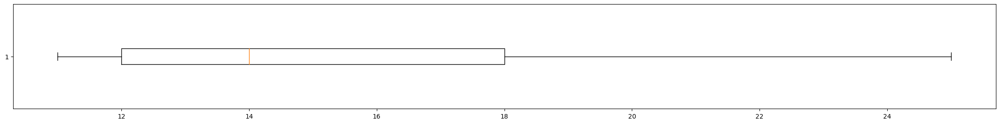

In [209]:
# Dispersión de los valores de la columna PercentSalaryHike a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['PercentSalaryHike'], vert = False)
plt.show()

In [210]:
# Análisis Univariado columna PercentSalaryHike
df['PercentSalaryHike'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean       15.191899
std         3.655746
min        11.000000
25%        12.000000
50%        14.000000
75%        18.000000
95%        22.000000
99%        25.000000
max        25.000000
Name: PercentSalaryHike, dtype: float64

### Limpieza y transformación columna PerformanceRating

In [211]:
# Reviso los valores únicos para PerformanceRating
df['PerformanceRating'].unique()

array([3, 4], dtype=int64)

In [212]:
# Análisis Univariado columna PerformanceRating
df['PerformanceRating'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        3.152722
std         0.359839
min         3.000000
25%         3.000000
50%         3.000000
75%         3.000000
95%         4.000000
99%         4.000000
max         4.000000
Name: PerformanceRating, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna RelationshipSatisfaction

In [213]:
# Reviso los valores únicos para RelationshipSatisfaction
df['RelationshipSatisfaction'].unique()

array([1, 4, 2, 3], dtype=int64)

In [214]:
# Análisis Univariado columna RelationshipSatisfaction
df['RelationshipSatisfaction'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        2.712483
std         1.080945
min         1.000000
25%         2.000000
50%         3.000000
75%         4.000000
95%         4.000000
99%         4.000000
max         4.000000
Name: RelationshipSatisfaction, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna StandardHours

In [215]:
# Reviso los valores únicos para StandardHours
df['StandardHours'].unique()

array([80., nan])

In [216]:
# Imputamos la variable StandardHours con la mediana
df['StandardHours'].fillna(df['StandardHours'].median(), inplace=True)

In [217]:
# Reviso los valores únicos para StandardHours
df['StandardHours'].unique()

array([80.])

<b>NOTA</b>: Variable con único valor para todas las instancias. Consideramos que es una variable que no aporta infomración y por tanto no la vamos a incluir en el modelo

### Limpieza y transformación columna StockOptionLevel

In [218]:
# Reviso los valores únicos para StockOptionLevel
df['StockOptionLevel'].unique()

array([0, 1, 3, 2], dtype=int64)

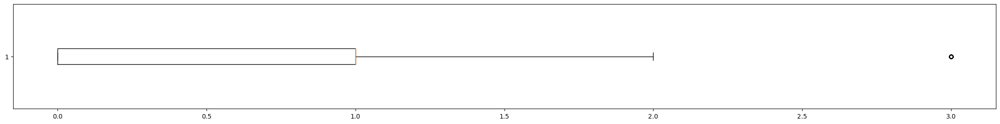

In [219]:
# Dispersión de los valores de la columna StockOptionLevel a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['StockOptionLevel'], vert = False)
plt.show()

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna TotalWorkingYears

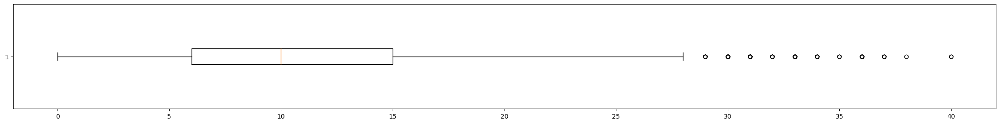

In [220]:
# Dispersión de los valores de la columna TotalWorkingYears a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['TotalWorkingYears'], vert = False)
plt.show()

In [221]:
# Análisis Univariado columna TotalWorkingYears
df['TotalWorkingYears'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean       11.220452
std         7.778530
min         0.000000
25%         6.000000
50%        10.000000
75%        15.000000
95%        28.000000
99%        34.950000
max        40.000000
Name: TotalWorkingYears, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna TrainingTimesLastYears

In [222]:
# Reviso los valores únicos para TrainingTimesLastYear
df['TrainingTimesLastYear'].unique()

array([0, 3, 2, 5, 1, 4, 6], dtype=int64)

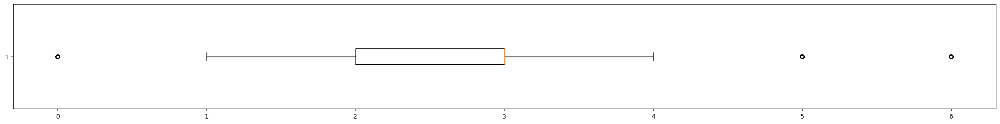

In [223]:
# Dispersión de los valores de la columna TrainingTimesLastYear a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['TrainingTimesLastYear'], vert = False)
plt.show()

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna WorkLifeBalance

In [224]:
# Reviso los valores únicos para WorkLifeBalance
df['WorkLifeBalance'].unique()

array([1, 3, 2, 4], dtype=int64)

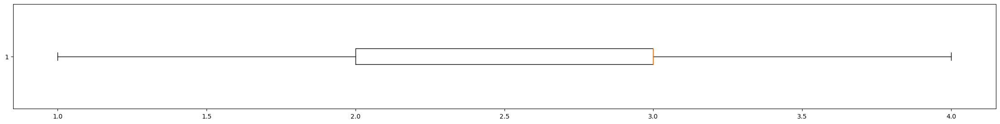

In [225]:
# Dispersión de los valores de la columna WorkLifeBalance a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['WorkLifeBalance'], vert = False)
plt.show()

### Limpieza y transformación columna YearsAtCompany

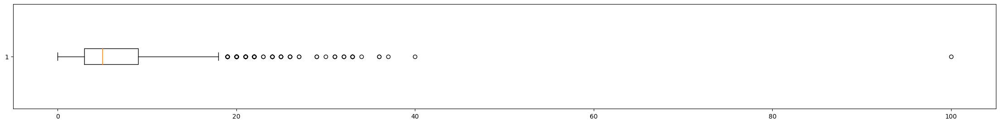

In [226]:
# Dispersión de los valores de la columna YearsAtCompany a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['YearsAtCompany'], vert = False)
plt.show()

In [227]:
# Análisis Univariado columna YearsAtCompany
df['YearsAtCompany'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        7.041169
std         6.568092
min         0.000000
25%         3.000000
50%         5.000000
75%         9.000000
95%        20.000000
99%        31.000000
max       100.000000
Name: YearsAtCompany, dtype: float64

In [228]:
# Función para corregir valores YearsAtCompany: si YearsAtCompany>=100 entonces YearsAtCompany/10
def arreglar_anhos_companhia(anhos):
    if anhos >= 100:
        return anhos / 10
    else:
        return anhos

In [229]:
# uso función para arreglar los valores de YearsAtCompany
df["YearsAtCompany"] = df["YearsAtCompany"].apply(arreglar_anhos_companhia)

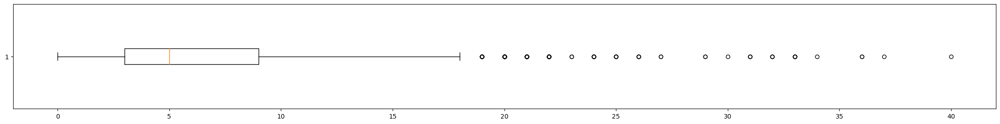

In [230]:
# Dispersión de los valores de la columna YearsAtCompany a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['YearsAtCompany'], vert = False)
plt.show()

### Limpieza y transformación columna YearsInCurrentRole

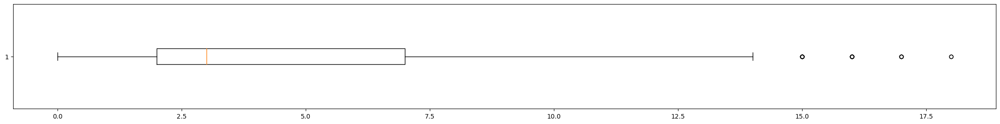

In [231]:
# Dispersión de los valores de la columna YearsInCurrentRole a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['YearsInCurrentRole'], vert = False)
plt.show()

In [232]:
# Análisis Univariado columna YearsInCurrentRole
df['YearsInCurrentRole'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        4.212483
std         3.618337
min         0.000000
25%         2.000000
50%         3.000000
75%         7.000000
95%        11.000000
99%        15.000000
max        18.000000
Name: YearsInCurrentRole, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna YearsSinceLastPromotion

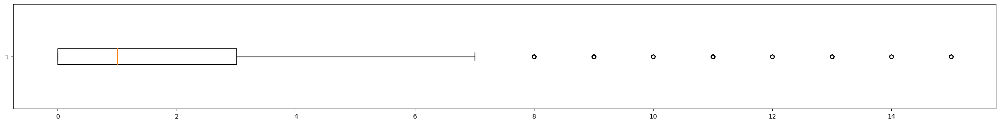

In [233]:
# Dispersión de los valores de la columna YearsSinceLastPromotion a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['YearsSinceLastPromotion'], vert = False)
plt.show()

In [234]:
# Análisis Univariado columna YearsSinceLastPromotion
df['YearsSinceLastPromotion'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        2.169987
std         3.196186
min         0.000000
25%         0.000000
50%         1.000000
75%         3.000000
95%         9.000000
99%        14.000000
max        15.000000
Name: YearsSinceLastPromotion, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

### Limpieza y transformación columna YearsWithCurrManager

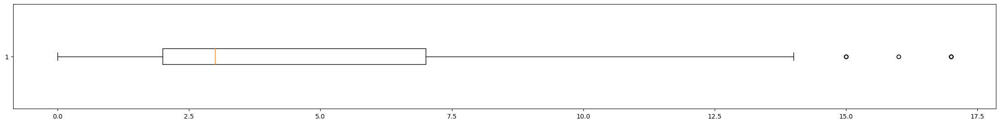

In [235]:
# Dispersión de los valores de la columna YearsSinceLastPromotion a través de un gráfico de cajas
plt.figure(figsize = (28, 3))
plt.boxplot(df['YearsWithCurrManager'], vert = False)
plt.show()

In [236]:
# Análisis Univariado columna YearsWithCurrManager
df['YearsWithCurrManager'].describe(percentiles = [.25, .5, .75, .95, .99])

count    1506.000000
mean        4.112882
std         3.572208
min         0.000000
25%         2.000000
50%         3.000000
75%         7.000000
95%        10.000000
99%        14.000000
max        17.000000
Name: YearsWithCurrManager, dtype: float64

<b>NOTA</b>: Variable para la cual no es necesario ningún tipo de limpieza y/o transformación

## Análisis Univariado

In [237]:
profile = ProfileReport(df)

In [238]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Análisis Bivariado

In [247]:
# Selección de features
objetivo = ['JobSatisfaction']
numericas = ['Age', 'Attrition', 'DailyRate', 'DistanceFromHome', 'Education', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'OverTime', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']
categoricas = ['BusinessTravel', 'Department', 'EducationField', 'JobRole', 'MaritalStatus']
excluidas = ['EmployeeCount', 'EmployeeNumber', 'Over18', 'StandardHours', 'NewEmployee']

In [255]:
# Selección conjunto de entranamiento y pruebas
df_train = df[(df['NewEmployee'] == 0)][objetivo + numericas + categoricas]
df_test = df[(df['NewEmployee'] == 1)][numericas + categoricas]

### Análisis variables numéricas

In [257]:
# Calculo matriz de correlaciones
df_train[objetivo + numericas].corr()

,JobSatisfaction,Age,Attrition,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
JobSatisfaction,1.000000,-0.006662,-0.104160,0.033041,-0.000678,-0.010619,-0.009773,0.030329,-0.066909,-0.014026,-0.004167,-0.010946,-0.008019,-0.056671,0.022160,0.012828,-0.003696,-0.006297,0.001223,-0.021613,0.001689,-0.022694,-0.003352,-0.003484,-0.017950,-0.024450
Age,-0.006662,1.000000,-0.155042,0.015407,-0.017311,0.201819,0.005908,-0.039708,0.018335,0.025686,0.510907,0.500311,0.029646,0.302023,0.022460,0.005457,0.001662,0.051468,0.040601,0.677996,-0.022187,-0.015525,0.315942,0.218466,0.219617,0.204804
Attrition,-0.104160,-0.155042,1.000000,-0.051461,0.075899,-0.034799,-0.111318,0.034161,-0.001218,-0.134822,-0.170808,-0.162427,0.003725,0.045987,0.254490,-0.014769,0.001415,-0.050142,-0.134654,-0.170391,-0.058439,-0.063539,-0.138656,-0.165612,-0.035886,-0.161172
DailyRate,0.033041,0.015407,-0.051461,1.000000,-0.001937,-0.020092,0.024917,-0.014408,0.028211,0.037402,-0.000552,0.006172,-0.026418,0.034036,0.014080,0.020542,-0.000696,0.008011,0.042150,0.013335,-0.000848,-0.043343,-0.038013,0.009090,-0.035123,-0.033456
DistanceFromHome,-0.000678,-0.017311,0.075899,-0.001937,1.000000,0.005601,-0.013389,0.013738,0.023198,0.001217,-0.000993,-0.023148,0.025197,-0.033622,0.018770,0.048587,0.033069,-0.001525,0.049665,-0.006519,-0.038545,-0.026106,0.004499,0.014514,0.004695,0.012686
Education,-0.010619,0.201819,-0.034799,-0.020092,0.005601,1.000000,-0.018804,-0.017520,0.010358,0.031655,0.107211,0.101062,-0.017066,0.132503,-0.009202,-0.010521,-0.027238,-0.007131,0.013622,0.150403,-0.025955,0.021927,0.073706,0.064206,0.052343,0.071668
EnvironmentSatisfaction,-0.009773,0.005908,-0.111318,0.024917,-0.013389,-0.018804,1.000000,0.002299,-0.052614,-0.001455,0.004102,-0.005276,0.035536,0.013212,0.064997,-0.029518,-0.025930,0.005326,0.005551,-0.001819,-0.013416,0.033973,0.000704,0.022953,0.016657,-0.004657
Gender,0.030329,-0.039708,0.034161,-0.014408,0.013738,-0.017520,0.002299,1.000000,-0.002310,0.013799,-0.045579,-0.038398,-0.049157,-0.043449,-0.035520,0.003185,-0.014057,0.020906,0.013425,-0.052686,-0.038349,-0.000559,-0.041263,-0.048740,-0.029763,-0.038783
HourlyRate,-0.066909,0.018335,-0.001218,0.028211,0.023198,0.010358,-0.052614,-0.002310,1.000000,0.043138,-0.036310,-0.023653,-0.012040,0.020930,-0.003552,-0.011293,-0.003293,-0.005282,0.054698,-0.011027,-0.007612,-0.006353,-0.028027,-0.032512,-0.029251,-0.030354
JobInvolvement,-0.014026,0.025686,-0.134822,0.037402,0.001217,0.031655,-0.001455,0.013799,0.043138,1.000000,-0.015503,-0.017969,-0.012270,0.021481,-0.006324,-0.016665,-0.027493,0.038142,0.026093,-0.012133,-0.012279,-0.022263,-0.029429,0.004950,-0.029832,0.018113


#### Conclusiones Análisis Bivariado - Variables Numéricas

1) Ninguna de las variables numéricas tiene correlación considerable vs la variable objetivo
2) Las variables JobLevel y MonthlyIncome estan altamente correlacionadas (0.950252), se toma la decesión de excluir la variable JobLevel ya que presenta correlaciones cosidereables contra otras variables.
3) Se observaron 7 correlaciones medias (entre 0.5 y 0.7) entre la variables.
4) Se observaron 6 correlaciones importantes (entre 0.7 y 0.8) entre la variables.

In [258]:
# Se actualiza el conjunto de variables numéricas excluyendo a JobLevel
numericas = ['Age', 'Attrition', 'DailyRate', 'DistanceFromHome', 'Education', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'OverTime', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']
excluidas = ['EmployeeCount', 'EmployeeNumber', 'Over18', 'StandardHours', 'NewEmployee', 'JobLevel']

### Análisis variables categóricas

Análisis de variables categóricas vs variable objetivo JobSatisfaction

In [259]:
# Creo función para poner los valores a las barras de los gráficos
def show_value_for_barplot(barplot, h_v="v"):
    if h_v == "v":
        for p in barplot.patches:
            barplot.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
    elif h_v == "h":
        for p in barplot.patches:
            # @param format(p.get_width(), '.2f'), word in string format you want to put in the figure
            # @param (p.get_width(), p.get_y()+ p.get_height() / 2.), x and y pos of word
            # @param xytext, offset of word
            barplot.annotate(format(p.get_width(), '.0f'), (p.get_width(), p.get_y()+ p.get_height() / 2.), ha = 'center', va = 'center', xytext = (30, 0), textcoords = 'offset points')

#### Análisis JobSatisfaction vs BusinessTravel

(0.0, 3.5)

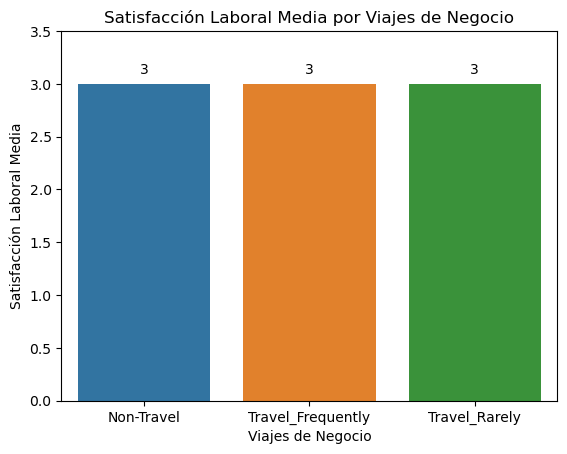

In [312]:
# Grafico JobSatisfaction vs BusinessTravel
agr1 = df.groupby('BusinessTravel')['JobSatisfaction'].median().round(0)
agr1 = agr1.reset_index()
splot1 = sns.barplot(x='BusinessTravel', y='JobSatisfaction', data=agr1)
show_value_for_barplot(splot1,h_v="v")
splot1.set(xlabel ="Viajes de Negocio", ylabel = "Satisfacción Laboral Media", title = "Satisfacción Laboral Media por Viajes de Negocio")
splot1.set_ylim(0, 3.5)

#### Análisis JobSatisfaction vs Department

(0.0, 3.5)

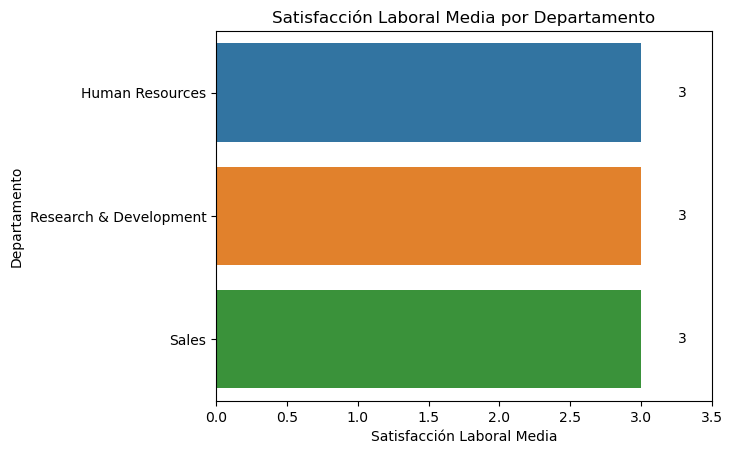

In [313]:
# Grafico JobSatisfaction vs Department
agr2 = df.groupby('Department')['JobSatisfaction'].median().round(0)
agr2 = agr2.reset_index()
splot2 = sns.barplot(x='JobSatisfaction', y='Department', data=agr2)
show_value_for_barplot(splot2,h_v="h")
splot2.set(xlabel ="Satisfacción Laboral Media", ylabel = "Departamento", title = "Satisfacción Laboral Media por Departamento")
splot2.set_xlim(0, 3.5)

#### Análisis JobSatisfaction vs EducationField

[Text(0, 0, 'Human Resources'),
 Text(1, 0, 'Life Sciences'),
 Text(2, 0, 'Marketing'),
 Text(3, 0, 'Medical'),
 Text(4, 0, 'Other'),
 Text(5, 0, 'Technical Degree')]

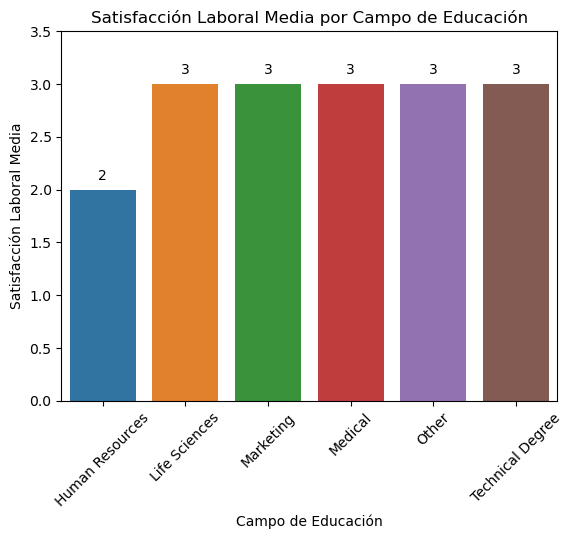

In [314]:
# Grafico JobSatisfaction vs EducationField
agr3 = df.groupby('EducationField')['JobSatisfaction'].median().round(0)
agr3 = agr3.reset_index()
splot3 = sns.barplot(x='EducationField', y='JobSatisfaction', data=agr3)
show_value_for_barplot(splot3,h_v="v")
splot3.set(xlabel ="Campo de Educación", ylabel = "Satisfacción Laboral Media", title = "Satisfacción Laboral Media por Campo de Educación")
splot3.set_ylim(0, 3.5)
splot3.set_xticklabels(splot3.get_xticklabels(),rotation = 45)

#### Análisis JobSatisfaction vs JobRole

(0.0, 3.5)

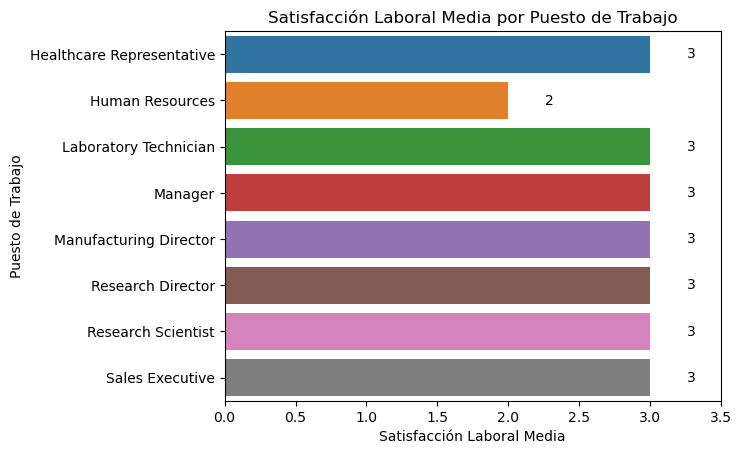

In [315]:
# Grafico JobSatisfaction vs JobRole
agr4 = df.groupby('JobRole')['JobSatisfaction'].median().round(0)
agr4 = agr4.reset_index()
splot4 = sns.barplot(x='JobSatisfaction', y='JobRole', data=agr4)
show_value_for_barplot(splot4,h_v="h")
splot4.set(xlabel ="Satisfacción Laboral Media", ylabel = "Puesto de Trabajo", title = "Satisfacción Laboral Media por Puesto de Trabajo")
splot4.set_xlim(0, 3.5)

#### Análisis JobSatisfaction vs MaritalStatus

(1.0, 3.5)

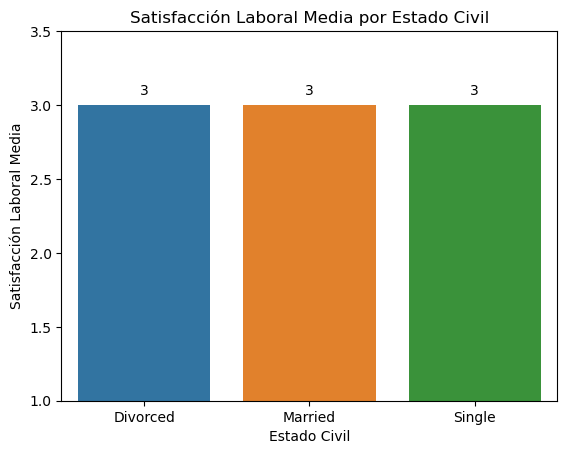

In [296]:
# Grafico JobSatisfaction vs MaritalStatus
agr5 = df.groupby('MaritalStatus')['JobSatisfaction'].median().round(0)
agr5 = agr5.reset_index()
splot5 = sns.barplot(x='MaritalStatus', y='JobSatisfaction', data=agr5)
show_value_for_barplot(splot5,h_v="v")
splot5.set(xlabel ="Estado Civil", ylabel = "Satisfacción Laboral Media", title = "Satisfacción Laboral Media por Estado Civil")
splot5.set_ylim(1, 3.5)

In [297]:
# Se actualiza el conjunto de variables categóricas
categoricas = ['EducationField', 'JobRole']
excluidas = ['EmployeeCount', 'EmployeeNumber', 'Over18', 'StandardHours', 'NewEmployee', 'JobLevel', 'BusinessTravel', 'Department', 'MaritalStatus']

In [299]:
# Actualización conjuntos de entranamiento y pruebas
df_train = df_train[objetivo + numericas + categoricas]
df_test = df_test[numericas + categoricas]

In [301]:
# Transformación variables Categóricas en Numéricas
df_train = pd.get_dummies(df_train, drop_first = True)
df_test = pd.get_dummies(df_test, drop_first = True)

#### Conclusiones Análisis Bivariado - Variables Categóricas

1) La Satisfacción Laboral Media de los diferentes valores de las variables categórcias Viajes de Negocio, Departamento y Estado Civil siempre es 3, por tanto consideramos que estas varaibles se pueden excluir porque tiene comportamiento constante y no le aportan al modelo.
2) Para las variables categóricas Campo Educación y Puesto de Trabajo, se observa que la Satisfacción Laboral Media es mejor para Recursos Humanos. Los empleados de Recursos Humanos poseen una satisfacción laboral menor que el resto de campos de educación y pruestos de trabajo.

### Conclusiones Análisis Bivariado


#### Variables más relevantes
* Luego de realizar los análisis Univariado y Bivariado no se identifican variables con relevancia importantes respecto a la variable obejtivo (Satisfacción Laboral).
* Por el momento solo se puede resaltar que Attrition (Desgastes) es la variables con mayor correlación (-0.104160) respecto a la variable objetivo.

#### Variables no relevantes
* Al realizar el análisis Univariado se excluyeron las varaibles EmployeeCount, EmployeeNumber, Over18, StandardHours, NewEmployee porque sus valores presentan alguna de las siguientes caraterísticas: 1) corresponden a identificadores únicos autoincrementados. 2) poseen el mismo valores en todas las instancias y 3) no aportan información al negocio. 

* Luego de realizar el análisis bivariado se excluyó la variable numérica JobLevel por su alta correlación con la varaible MonthlyIncome. Mientras que para las variables categóricas se excluyeron BusinessTravel, Department y MaritalStatus, debido a la satisfacción laboral media para sus diferentes valores es la misma (3) lo cual no aporta al modelo.

## Construcción y Selección del Mejor Modelo

#### Definición conjuntos entrenamiento y pruebas

In [307]:
features = ['Age', 'Attrition', 'DailyRate', 'DistanceFromHome', 'Education', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'OverTime', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager', 'EducationField_Life Sciences', 'EducationField_Marketing', 'EducationField_Medical', 'EducationField_Other', 'EducationField_Technical Degree', 'JobRole_Human Resources', 'JobRole_Laboratory Technician', 'JobRole_Manager', 'JobRole_Manufacturing Director', 'JobRole_Research Director', 'JobRole_Research Scientist', 'JobRole_Sales Executive']
X = df_train[features]
Y = df_train[objetivo]

In [309]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 1)

In [310]:
X_train.shape

(1195, 36)

In [311]:
X_test.shape

(299, 36)

#### Escalando las características

### Modelo 1: Regresión Logística

#### Entrenando el Modelo 1

#### Evaluando el Modelo 1

### Modelo 2: Árbol de Decisión

#### Entrenando el Modelo 2

#### Evaluando el Modelo 2

### Modelo 3: Random Forest

#### Entrenando el Modelo 3

#### Evaluando el Modelo 3

### Modelo 4: ???

#### Entrenando el Modelo 4

#### Evaluando el Modelo 4

### Modelo 5: ???

#### Entrenando el Modelo 5

#### Evaluando el Modelo 5

## Interpretación

## Evaluación

## Estimación del Nivel de Satisfacción de Nuevos Empleados